In [19]:
# Notes: https://basicpitch.spotify.com/
# https://nussl.github.io/docs/tutorials/audio_signal_basics.html

In [20]:
import nussl
import matplotlib.pyplot as plt
import time
import numpy as np
import warnings
import torch
import os

warnings.filterwarnings("ignore")
start_time = time.time()

nussl.utils.seed(0)

def visualize_and_embed(sources):
    plt.figure(figsize=(10, 6))
    plt.subplot(211)
    nussl.utils.visualize_sources_as_masks(sources,
        y_axis='mel', db_cutoff=-40, alpha_amount=2.0)
    plt.subplot(212)
    nussl.utils.visualize_sources_as_waveform(
        sources, show_legend=False)
    plt.show()
    nussl.play_utils.multitrack(sources)

# musdb = nussl.datasets.MUSDB18(
#     download=True, sample_rate=16000,
#     strict_sample_rate = False
# )

print(torch.cuda.is_available())

True


In [21]:
def run(self):
        P, Q = self.initialize_parameters()
        for i in range(self.num_iterations):
            P, Q = self._update(P, Q)

        KQ = self._get_kq(Q)
        KQ = KQ.reshape(KQ.shape[0], -1, 1, KQ.shape[-1])
        sigma_j = KQ * P[:, None, ...]
        sigma_j = sigma_j / (self.eps + sigma_j.sum(dim=-1)[..., None])
        sigma_j = self._convert_to_numpy(sigma_j)

        self.projection_set = self.projection_set.reshape(
            self.projection_set.shape[0],
            self.projection_set.shape[1] * self.projection_set.shape[2],
            self.projection_set.shape[-1]
        )

        self.inverse_projection_set = np.linalg.pinv(self.projection_set)

        cf_j = (
                (self.projection_set @
                 self.stft.transpose(0, 2, 1))[..., None]
                * sigma_j
        )
        shape = cf_j.shape

        reconstructions = (
                self.inverse_projection_set @
                cf_j.reshape(
                    cf_j.shape[0],
                    cf_j.shape[1],
                    -1
                )
        )
        reconstructions = reconstructions.reshape(
            shape[0], self.stft.shape[-1], -1, shape[-1]
        )

        self.reconstructions = np.swapaxes(reconstructions, 1, 2)

        return reconstructions

def _update(self, P, Q):
        KQ = self._get_kq(Q)
        sigma = self._update_sigma(P, Q, KQ)
        P = self._update_P(P, sigma, KQ)
        P[P < 1e-300] = 1e-300
        sigma = self._update_sigma(P, Q, KQ)
        Q = self._update_Q(P, sigma, Q)
        Q[Q < 1e-300] = 1e-300
        return P, Q

nussl.separation.spatial.projet.Projet.run = run
nussl.separation.spatial.projet.Projet._update = _update

In [22]:
curr_dir = os.getcwd()
combos_dir = os.path.join(curr_dir, 'combos')

In [23]:
def visualize_and_embed_notebook(sources):
    plt.figure(figsize=(10, 6))
    plt.subplot(211)
    nussl.utils.visualize_sources_as_masks(sources,
        y_axis='mel', db_cutoff=-40, alpha_amount=2.0)
    plt.subplot(212)
    nussl.utils.visualize_sources_as_waveform(
        sources, show_legend=False)
    plt.show()
    nussl.play_utils.multitrack(sources)

def graph(sources, song_name):
    plt.figure(figsize=(10, 6))
    plt.subplot(211)
    nussl.utils.visualize_sources_as_masks(sources,
        y_axis='mel', db_cutoff=-40, alpha_amount=2.0)
    plt.subplot(212)
    nussl.utils.visualize_sources_as_waveform(
        sources, show_legend=False)
    plt.show()

def audio(sources):
    nussl.play_utils.multitrack(sources)

def visualize(song_name):
    
    start_time = time.time()

    combo_name = "%s-combined.npy" %(song_name)
    combo_path = os.path.join(combos_dir, combo_name)

    final_ests = []
    with open(combo_path, 'rb') as f:
        final_ests = np.load(f, allow_pickle=True)

    fin_estimates = {f'Source {i}': e for i, e in enumerate(final_ests)}
    end_time = time.time()
    time_taken = end_time - start_time
    time_string = f'Time taken: {time_taken:.4f} seconds'
    return graph(fin_estimates, song_name)

def generate_audio(song_name):
    
    start_time = time.time()

    combo_name = "%s-combined.npy" %(song_name)
    combo_path = os.path.join(combos_dir, combo_name)

    final_ests = []
    with open(combo_path, 'rb') as f:
        final_ests = np.load(f, allow_pickle=True)

    fin_estimates = {f'Source {i}': e for i, e in enumerate(final_ests)}
    end_time = time.time()
    time_taken = end_time - start_time
    time_string = f'Time taken: {time_taken:.4f} seconds'
    return audio(fin_estimates)

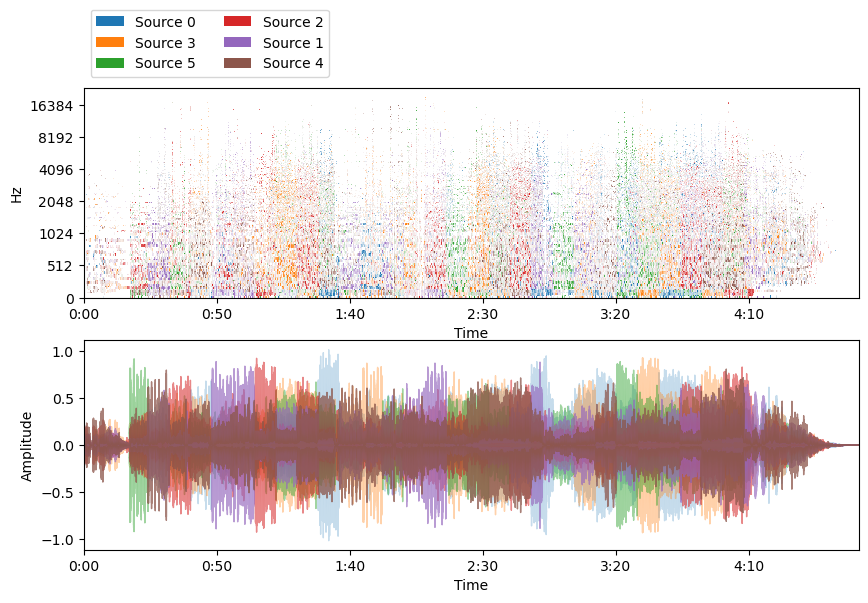


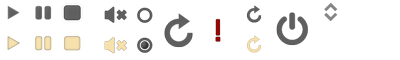
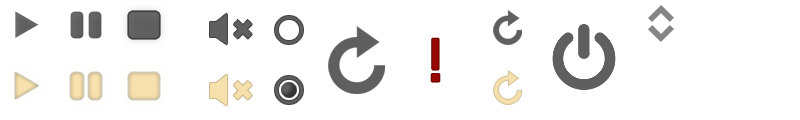
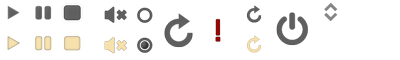

In [25]:
visualize("so-much-for-stardust.wav")
generate_audio("so-much-for-stardust.wav")

In [ ]:
end_time = time.time()
time_taken = end_time - start_time
print(f'Time taken: {time_taken:.4f} seconds')

Time taken: 42.2316 seconds
